<a href="https://colab.research.google.com/github/Jotadebeese/Rubbish-Classifier-Updated/blob/main/experiment_tracking/experiment_tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Experiment Tracking with PyTorch

In [1]:
import torch
import torchvision

print(torch.__version__)
print(torchvision.__version__)

2.1.0+cu121
0.16.0+cu121


In [2]:
 # Continue with regular imports
import matplotlib.pyplot as plt
import torch
import torchvision

from torch import nn
from torchvision import transforms

# Try to get torchinfo, install it if it doesn't work
try:
    from torchinfo import summary
except:
    print("[INFO] Couldn't find torchinfo... installing it.")
    !pip install -q torchinfo
    from torchinfo import summary

# Try to import the PyTorch Scripts directory, download it from GitHub
try:
    from modular_scripts import data_setup, engine, utils
except:
    # Get the scripts
    print("[INFO] Couldn't find scripts, downloading them from GitHub.")
    !git clone https://github.com/Jotadebeese/pytorch_scripts
    !mv pytorch_scripts/modular_scripts .
    !rm -rf pytorch_scripts
    from modular_scripts import data_setup, engine, utils

[INFO] Couldn't find torchinfo... installing it.
[INFO] Couldn't find scripts, downloading them from GitHub.
Cloning into 'pytorch_scripts'...
remote: Enumerating objects: 212, done.
remote: Counting objects: 100% (212/212), done.
remote: Compressing objects: 100% (113/113), done.
remote: Total 212 (delta 119), reused 190 (delta 97), pack-reused 0
Receiving objects: 100% (212/212), 50.96 KiB | 4.63 MiB/s, done.
Resolving deltas: 100% (119/119), done.
[INFO] splitfolders module not found. Installing...


In [3]:
# Setup device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [4]:
# Set seeds
def set_seeds(seed: int=42):
    """Sets random sets for torch operations.

    Args:
        seed (int, optional): Random seed to set. Defaults to 42.
    """
    # Set the seed for general torch operations
    torch.manual_seed(seed)
    # Set the seed for CUDA torch operations (ones that happen on the GPU)
    torch.cuda.manual_seed(seed)

## 1. Get data

In [5]:
image_path = utils.download_data(source='1af3v28i-dawXpzbe9peR0oylgdXEAc9R',
                                 destination='rubbish_dataset',
                                 from_gdrive=True)

image_path

'data/rubbish_dataset' does not exist, creating directory...
[INFO] Donwloading 1af3v28i-dawXpzbe9peR0oylgdXEAc9R from https://drive.google.com/uc?id=1af3v28i-dawXpzbe9peR0oylgdXEAc9R


Downloading...
From: https://drive.google.com/uc?id=1af3v28i-dawXpzbe9peR0oylgdXEAc9R
To: /content/data/1af3v28i-dawXpzbe9peR0oylgdXEAc9R
100%|██████████| 549M/549M [00:01<00:00, 329MB/s]


[INFO] Unzipping 1af3v28i-dawXpzbe9peR0oylgdXEAc9R data...


PosixPath('data/rubbish_dataset')

### 1.1 Convert images to jpg format

In [6]:
utils.bulk_image_convertor(dataset_path='data/rubbish_dataset/rubbish_dataset',
                    format="jpg")

743it [00:00, 164678.07it/s]


0 images converted to 'jpg' in 'data/rubbish_dataset/rubbish_dataset/paper'


672it [00:00, 139491.85it/s]


0 images converted to 'jpg' in 'data/rubbish_dataset/rubbish_dataset/metal'


456it [00:04, 96.08it/s]


125 images converted to 'jpg' in 'data/rubbish_dataset/rubbish_dataset/trash'


632it [00:00, 120157.75it/s]


0 images converted to 'jpg' in 'data/rubbish_dataset/rubbish_dataset/plastic'


492it [00:02, 228.49it/s]


66 images converted to 'jpg' in 'data/rubbish_dataset/rubbish_dataset/cardboard'


772it [00:01, 536.64it/s]

42 images converted to 'jpg' in 'data/rubbish_dataset/rubbish_dataset/glass'


### 1.2 Explit into Train, Val and Test dataset

In [7]:
train_dir, test_dir, val_dir = utils.split_data(input_folder='data/rubbish_dataset/rubbish_dataset', output_folder=image_path)

train_dir, test_dir, val_dir

Copying files: 3767 files [00:00, 3969.08 files/s]


(PosixPath('data/rubbish_dataset/train'),
 PosixPath('data/rubbish_dataset/test'),
 PosixPath('data/rubbish_dataset/val'))

## 2. Datasets and DataLoaders

### 2.1 Manual Transforms

In [8]:
# ImageNet normalization levels
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

manual_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    normalize
])
print(f"Manually created transforms{manual_transforms}")

# Data loaders
train_dataLoader, test_dataLoader, class_names = data_setup.create_dataLoaders(
    train_dir=train_dir,
    test_dir=test_dir,
    transform=manual_transforms,
    batch_size=32
)

train_dataLoader, test_dataLoader, class_names

Manually created transformsCompose(
    Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=warn)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)


(<torch.utils.data.dataloader.DataLoader at 0x7d966ca61450>,
 ['cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash'])

### 2.2 Automatic Transforms

In [9]:
# Pretrained weights
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT

# Transformers from weights
automatic_transforms = weights.transforms()
print(f"Automatically created transforms: {automatic_transforms}")

train_dataLoader, test_dataLoader, class_names = data_setup.create_dataLoaders(
    train_dir=train_dir,
    test_dir=test_dir,
    transform=automatic_transforms,
    batch_size=32
)

train_dataLoader, test_dataLoader, class_names

Automatically created transforms: ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)


(<torch.utils.data.dataloader.DataLoader at 0x7d973bc0ee30>,
 ['cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash'])

## 3. Getting a pretrained model, freeze the base layers and change the classififer head

In [10]:
from torchvision.models import efficientnet_b0, EfficientNet_B0_Weights
from torchvision.models._api import WeightsEnum
from torch.hub import load_state_dict_from_url

def get_state_dict(self, *args, **kwargs):
  kwargs.pop("check_hash")
  return load_state_dict_from_url(self.url, *args, **kwargs)
WeightsEnum.get_state_dict = get_state_dict

# Download pretrained weights for EfficientNet_B0
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # Best available
model = torchvision.models.efficientnet_b0(weights=weights).to(device)

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-3dd342df.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 268MB/s]


In [11]:
# Freez all base layers by setting their requires_grad attribute to False
for param in model.features.parameters():
  param.requires_grad = False

In [12]:
# Adjust the classifier head
set_seeds()
model.classifier = nn.Sequential(
    nn.Dropout(p=0.2, inplace=True),
    nn.Linear(in_features=1280, out_features=len(class_names))
).to(device)

In [13]:
from torchinfo import summary

summary(model,
        input_size=(32,3,224,224),
        verbose=0,
        col_names=["input_size", 'output_size', 'num_params', 'trainable'],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 6]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

## 4. Train a single model and track results

In [14]:
# Define loss function and optimizer
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [15]:
# Set up a SummaryWriter
from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter()
writer

In [16]:
from tqdm.auto import tqdm
from typing import Dict, List, Tuple

from modular_scripts.engine import train_step, test_step

def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device) -> Dict[str, List]:

    """Trains and tests a PyTorch model.

    Passes a target PyTorch models through train_step() and test_step()
    functions for a number of epochs, training and testing the model
    in the same epoch loop.

    Calculates, prints and stores evaluation metrics throughout.

    Args:
        model: A PyTorch model to be trained and tested.
        train_dataloader: A DataLoader instance for the model to be trained on.
        test_dataloader: A DataLoader instance for the model to be tested on.
        optimizer: A PyTorch optimizer to help minimize the loss function.
        loss_fn: A PyTorch loss function to calculate loss on both datasets.
        epochs: An integer indicating how many epochs to train for.
        device: A target device to compute on (e.g. "cuda" or "cpu").

    Returns:
        A dictionary of training and testing loss as well as training and
        testing accuracy metrics. Each metric has a value in a list for
        each epoch.
        In the form: {train_loss: [...],
                    train_acc: [...],
                    test_loss: [...],
                    test_acc: [...]}
        For example if training for epochs=2:
                    {train_loss: [2.0616, 1.0537],
                    train_acc: [0.3945, 0.3945],
                    test_loss: [1.2641, 1.5706],
                    test_acc: [0.3400, 0.2973]}
    """
    # Create empty results dictionary
    results = {"train_loss": [],
        "train_acc": [],
        "test_loss": [],
        "test_acc": []
    }

    # Loop through training and testing steps for a number of epochs
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                        dataloader=train_dataloader,
                                        loss_fn=loss_fn,
                                        optimizer=optimizer,
                                        device=device)
        test_loss, test_acc = test_step(model=model,
                                        dataloader=test_dataloader,
                                        loss_fn=loss_fn,
                                        device=device)

        # Print out what's happening
        print(
            f"Epoch: {epoch+1} | "
            f"train_loss: {train_loss:.4f} | "
            f"train_acc: {train_acc:.4f} | "
            f"test_loss: {test_loss:.4f} | "
            f"test_acc: {test_acc:.4f}"
        )

        # Update results dictionary
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)

        ### New: Experiment tracking ###
        writer.add_scalars(main_tag="Loss",
                           tag_scalar_dict={"train_loss": train_loss,
                                            "test_loss": test_loss},
                           global_step=epoch)
        writer.add_scalars(main_tag="Accuracy",
                           tag_scalar_dict={"train_acc": train_acc,
                                            "test_acc": test_acc},
                           global_step=epoch)
        writer.add_graph(model=model,
                         input_to_model=torch.randn(32,3,224,224).to(device))
    # Close the writer
    writer.close()
    ## End New ###

    # Return the filled results at the end of the epochs
    return results



In [17]:
# Train Model
set_seeds()
results = train(model=model,
                train_dataloader=train_dataLoader,
                test_dataloader=test_dataLoader,
                optimizer=optimizer,
                loss_fn=loss_fn,
                epochs=5,
                device=device)

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.3281 | train_acc: 0.5240 | test_loss: 0.9220 | test_acc: 0.7236
Epoch: 2 | train_loss: 0.9313 | train_acc: 0.7023 | test_loss: 0.7522 | test_acc: 0.7608
Epoch: 3 | train_loss: 0.8240 | train_acc: 0.7132 | test_loss: 0.7021 | test_acc: 0.7556
Epoch: 4 | train_loss: 0.7633 | train_acc: 0.7451 | test_loss: 0.6833 | test_acc: 0.7606
Epoch: 5 | train_loss: 0.7088 | train_acc: 0.7615 | test_loss: 0.6642 | test_acc: 0.7686


## 5. View our model's results with TensorBoard

In [18]:
# view experiments from within the notebook
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

## 6. Function to prepare a `SummaryWriter()` instance

We want to track:
* Experiment date/timestamp
* Experiment name
* Model name

We wanto track experiments to a directory like as followa:
`runs/YYYY-MM-DD/experiment_name/model_name/extra`

In [19]:
from torch.utils.tensorboard import SummaryWriter
def create_writer(experiment_name: str,
                  model_name: str,
                  extra: str = None):
  """Creates a torch.utils.tensorboard.writer.SummaryWriter() instance tracking to a specific log_dir"""
  from datetime import datetime
  import os

  timestamp = datetime.now().strftime("%Y-%m-%d")

  if extra:
    log_dir = os.path.join("runs", timestamp, experiment_name, model_name, extra)
  else:
    log_dir = os.path.join("runs", timestamp, experiment_name, model_name)
  print(f"[INFO] Created SummaryWriter saving to {log_dir}")
  return SummaryWriter(log_dir=log_dir)


In [20]:
create_writer("test_1", "model_1", "juan")

[INFO] Created SummaryWriter saving to runs/2024-01-02/test_1/model_1/juan


### 6.1 Update `train()` function to use a `writer()` parameter

In [21]:
from tqdm.auto import tqdm
from typing import Dict, List, Tuple

from modular_scripts.engine import train_step, test_step

def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device,
          writer: torch.utils.tensorboard.writer.SummaryWriter) -> Dict[str, List]:

    """Trains and tests a PyTorch model.

    Passes a target PyTorch models through train_step() and test_step()
    functions for a number of epochs, training and testing the model
    in the same epoch loop.

    Calculates, prints and stores evaluation metrics throughout.

    Args:
        model: A PyTorch model to be trained and tested.
        train_dataloader: A DataLoader instance for the model to be trained on.
        test_dataloader: A DataLoader instance for the model to be tested on.
        optimizer: A PyTorch optimizer to help minimize the loss function.
        loss_fn: A PyTorch loss function to calculate loss on both datasets.
        epochs: An integer indicating how many epochs to train for.
        device: A target device to compute on (e.g. "cuda" or "cpu").

    Returns:
        A dictionary of training and testing loss as well as training and
        testing accuracy metrics. Each metric has a value in a list for
        each epoch.
        In the form: {train_loss: [...],
                    train_acc: [...],
                    test_loss: [...],
                    test_acc: [...]}
        For example if training for epochs=2:
                    {train_loss: [2.0616, 1.0537],
                    train_acc: [0.3945, 0.3945],
                    test_loss: [1.2641, 1.5706],
                    test_acc: [0.3400, 0.2973]}
    """
    # Create empty results dictionary
    results = {"train_loss": [],
        "train_acc": [],
        "test_loss": [],
        "test_acc": []
    }

    # Loop through training and testing steps for a number of epochs
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                        dataloader=train_dataloader,
                                        loss_fn=loss_fn,
                                        optimizer=optimizer,
                                        device=device)
        test_loss, test_acc = test_step(model=model,
                                        dataloader=test_dataloader,
                                        loss_fn=loss_fn,
                                        device=device)

        # Print out what's happening
        print(
            f"Epoch: {epoch+1} | "
            f"train_loss: {train_loss:.4f} | "
            f"train_acc: {train_acc:.4f} | "
            f"test_loss: {test_loss:.4f} | "
            f"test_acc: {test_acc:.4f}"
        )

        # Update results dictionary
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)

        if writer:
          ### New: Experiment tracking ###
          writer.add_scalars(main_tag="Loss",
                            tag_scalar_dict={"train_loss": train_loss,
                                              "test_loss": test_loss},
                            global_step=epoch)
          writer.add_scalars(main_tag="Accuracy",
                            tag_scalar_dict={"train_acc": train_acc,
                                              "test_acc": test_acc},
                            global_step=epoch)
          writer.add_graph(model=model,
                          input_to_model=torch.randn(32,3,224,224).to(device))
          # Close the writer
          writer.close()
        else:
          pass
      ## End New ###

    # Return the filled results at the end of the epochs
    return results

## 7. Setting Up a series of modelling experiments

### 7.1 Experiments:

* Different number of epochs
* Number of hiddne layers/units
* Amount of data
* Chain the learning rate
* Different kinds of data augmentation
* Different model architecture

**Experiments we will run:**

1. Model size - EffnetB0 vs EffnetB2
2. Data size
3. Training time - 5 epochs vs 10 epochs

### 7.2 Download a different Dataset

1. New Rubbish Dataset (Including Organic)
2. Augmented Rubbish Dataset

In [22]:
image_path_augmented = utils.download_data(source='1jGCybRl5NkbGM6EnrK8wri5FeqJrSXg8',
                                 destination='rubbish_dataset_augmented',
                                 from_gdrive=True)

image_path_new = utils.download_data(source='1xTjzhLoX5X-posqXhZ_cc1LOw5KeScTt',
                                 destination='new_rubbish_dataset',
                                 from_gdrive=True)

'data/rubbish_dataset_augmented' does not exist, creating directory...
[INFO] Donwloading 1jGCybRl5NkbGM6EnrK8wri5FeqJrSXg8 from https://drive.google.com/uc?id=1jGCybRl5NkbGM6EnrK8wri5FeqJrSXg8


Downloading...
From: https://drive.google.com/uc?id=1jGCybRl5NkbGM6EnrK8wri5FeqJrSXg8
To: /content/data/1jGCybRl5NkbGM6EnrK8wri5FeqJrSXg8
100%|██████████| 2.47G/2.47G [00:09<00:00, 274MB/s]


[INFO] Unzipping 1jGCybRl5NkbGM6EnrK8wri5FeqJrSXg8 data...
'data/new_rubbish_dataset' does not exist, creating directory...
[INFO] Donwloading 1xTjzhLoX5X-posqXhZ_cc1LOw5KeScTt from https://drive.google.com/uc?id=1xTjzhLoX5X-posqXhZ_cc1LOw5KeScTt


Downloading...
From: https://drive.google.com/uc?id=1xTjzhLoX5X-posqXhZ_cc1LOw5KeScTt
To: /content/data/1xTjzhLoX5X-posqXhZ_cc1LOw5KeScTt
100%|██████████| 642M/642M [00:02<00:00, 292MB/s]


[INFO] Unzipping 1xTjzhLoX5X-posqXhZ_cc1LOw5KeScTt data...


In [23]:
utils.bulk_image_convertor(dataset_path='data/rubbish_dataset_augmented/rubbish_dataset_augmented',
                    format="jpg")
utils.bulk_image_convertor(dataset_path='data/new_rubbish_dataset/new_rubbish_dataset',
                    format="jpg")

4228it [00:00, 200322.14it/s]


0 images converted to 'jpg' in 'data/rubbish_dataset_augmented/rubbish_dataset_augmented/paper'


3156it [00:00, 185720.43it/s]


0 images converted to 'jpg' in 'data/rubbish_dataset_augmented/rubbish_dataset_augmented/metal'


593it [00:03, 161.02it/s]


125 images converted to 'jpg' in 'data/rubbish_dataset_augmented/rubbish_dataset_augmented/trash'


3692it [00:00, 192745.55it/s]


0 images converted to 'jpg' in 'data/rubbish_dataset_augmented/rubbish_dataset_augmented/organic'


3042it [00:00, 194563.31it/s]


0 images converted to 'jpg' in 'data/rubbish_dataset_augmented/rubbish_dataset_augmented/plastic'


3274it [00:01, 1748.69it/s]


66 images converted to 'jpg' in 'data/rubbish_dataset_augmented/rubbish_dataset_augmented/cardboard'


5674it [00:01, 4454.98it/s]


42 images converted to 'jpg' in 'data/rubbish_dataset_augmented/rubbish_dataset_augmented/glass'


743it [00:00, 166998.97it/s]


0 images converted to 'jpg' in 'data/new_rubbish_dataset/new_rubbish_dataset/paper'


672it [00:00, 153025.26it/s]


0 images converted to 'jpg' in 'data/new_rubbish_dataset/new_rubbish_dataset/metal'


456it [00:03, 121.99it/s]


125 images converted to 'jpg' in 'data/new_rubbish_dataset/new_rubbish_dataset/trash'


3692it [00:00, 174122.05it/s]


0 images converted to 'jpg' in 'data/new_rubbish_dataset/new_rubbish_dataset/organic'


632it [00:00, 133980.29it/s]


0 images converted to 'jpg' in 'data/new_rubbish_dataset/new_rubbish_dataset/plastic'


492it [00:01, 266.50it/s]


66 images converted to 'jpg' in 'data/new_rubbish_dataset/new_rubbish_dataset/cardboard'


772it [00:01, 610.57it/s]

42 images converted to 'jpg' in 'data/new_rubbish_dataset/new_rubbish_dataset/glass'


In [24]:
train_dir_augmented, test_dir_augmented, val_dir_augmented = utils.split_data(input_folder='data/rubbish_dataset_augmented/rubbish_dataset_augmented', output_folder=image_path_augmented)
new_train_dir, new_test_dir, new_val_dir = utils.split_data(input_folder='data/new_rubbish_dataset/new_rubbish_dataset', output_folder=image_path_new)

train_dir_augmented, test_dir_augmented, val_dir_augmented, new_train_dir, new_test_dir, new_val_dir

Copying files: 23659 files [00:06, 3648.54 files/s]
Copying files: 7459 files [00:01, 4904.59 files/s]


(PosixPath('data/rubbish_dataset_augmented/train'),
 PosixPath('data/rubbish_dataset_augmented/test'),
 PosixPath('data/rubbish_dataset_augmented/val'),
 PosixPath('data/new_rubbish_dataset/train'),
 PosixPath('data/new_rubbish_dataset/test'),
 PosixPath('data/new_rubbish_dataset/val'))

### 7.3 Transform datasets and create DataLoaders

1. Resize the images to (224, 224)
2. Make sure image tensor values ae between [0, 1]
3. Normalize the images to have same data distribution as ImageNet

In [25]:
from torchvision import transforms

# Setup ImageNet normalization levels
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

# Compose transforms into a pipeline
simple_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    normalize
])

In [26]:
BATCH_SIZE =32

# Create training and testing dataloader for new dataset
new_train_dataLoader, new_test_dataLoader, new_class_names = data_setup.create_dataLoaders(
    train_dir=new_train_dir,
    test_dir=new_test_dir,
    transform=simple_transform,
    batch_size=BATCH_SIZE
)

# Create training and testing dataloader for augmented dataset
augmented_train_dataLoader, new_test_dataLoader, new_class_names = data_setup.create_dataLoaders(
    train_dir=train_dir_augmented,
    test_dir=test_dir_augmented,
    transform=simple_transform,
    batch_size=BATCH_SIZE
)

print(f"Number of batches of size {BATCH_SIZE} in new train data: {len(new_train_dataLoader)}")
print(f"Number of batches of size {BATCH_SIZE} in augmented train data: {len(augmented_train_dataLoader)}")
print(f"Number of batches of size {BATCH_SIZE} in new test data: {len(new_test_dataLoader)}")
print(f"Class names: {new_class_names}")

Number of batches of size 32 in new train data: 187
Number of batches of size 32 in augmented train data: 592
Number of batches of size 32 in new test data: 75
Class names: ['cardboard', 'glass', 'metal', 'organic', 'paper', 'plastic', 'trash']


### 7.4 Create feature extractor models

Two functions:

1. `torchvision.models.efficientnet_b0()` feature extractor with a frozen backbone/base layers and a custom classifier head.
2. `torchvision.models.efficientnet_b2()` feature extractor with a frozen backbone/base layers and a custom classifier head.

In [27]:
import torchvision

# Create an EffNetB2
effnetb2_weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT # "Default" best available
test_model = torchvision.models.efficientnet_b2(weights=effnetb2_weights)

Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-bcdf34b7.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-bcdf34b7.pth
100%|██████████| 35.2M/35.2M [00:00<00:00, 257MB/s]


In [28]:
summary(test_model,
        input_size=(32,3,224,224),
        verbose=0,
        col_names=["input_size", 'output_size', 'num_params', 'trainable'],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 1000]           --                   True
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1408, 7, 7]     --                   True
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   True
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   864                  True
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   64                   True
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 16, 112

In [29]:
import torchvision
from torch import nn

OUT_FEATURES = len(new_class_names)

# Create an EffNetB0 feature extractor
def create_effnetb0():
  # Get the weights and setup a model
  weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
  model = torchvision.models.efficientnet_b0(weights=weights).to(device)

  # Freeze the base model layers
  for param in model.features.parameters():
    param.requires_grad = False

  # Change the classifier head
  #set_seeds()
  model.classifier = nn.Sequential(
      nn.Dropout(p=0.2, inplace=True),
      nn.Linear(in_features=1280, out_features=OUT_FEATURES)
  ).to(device)

  # Give the model a name
  model.name = "effnetb0"
  print(f"[INFO] Created new {model.name} model...")

  return model

# Create an EffNetB2 feature extractor
def create_effnetb2():
  # Get the weights and setup a model
  weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
  model = torchvision.models.efficientnet_b2(weights=weights).to(device)

  # Freeze the base model layers
  for param in model.features.parameters():
    param.requires_grad = False

  # Change the classifier head
  #set_seeds()
  model.classifier = nn.Sequential(
      nn.Dropout(p=0.3, inplace=True),
      nn.Linear(in_features=1408, out_features=OUT_FEATURES)
  ).to(device)

  # Give the model a name
  model.name = "effnetb2"
  print(f"[INFO] Created new {model.name} model...")

  return model

### 7.6 Create experiments and set up training code

In [30]:
# Create epoch list
num_epochs = [5, 10]

# Create models list (need to create a new model for each experiment)
models = ["effnetb0", 'effnetb2']

# Create a DataLoaders dictionary
train_dataLoaders = {"new_dataset": new_train_dataLoader,
                     "augmented_dataset": augmented_train_dataLoader}

In [32]:
%%time
from modular_scripts.utils import save_model
from modular_scripts.engine import train_with_writer, create_writer

# Set seeds
# set_seeds(seed=42)

# Kepp track of experiment numbers
experiment_number = 0

# Loop thorugh each DataLoader
for dataloader_name, train_dataloader in train_dataLoaders.items():
  # Loop through the epochs
  for epochs in num_epochs:
    # Loop through each model name and create a new model instance
    for model_name in models:
      # Print out info
      experiment_number += 1
      print(f"[INFO] Experiment number: {experiment_number}")
      print(f"[INFO] Model: {model_name}")
      print(f"[INFO] DataLoader: {dataloader_name}")
      print(f"[INFO] Number of Epochs: {epochs}")
      print("-"*50)

      # Select and create the model
      if model_name == 'effnetb0':
        model = create_effnetb0()
      else:
        model = create_effnetb2()

      # Create a new loss and optimizer for everymodel
      loss_fn = nn.CrossEntropyLoss()
      optimizer = torch.optim.Adam(params=model.parameters(), lr=0.001)

      # Train target model with target dataLoader and track experiments
      # NOTE: Using train with writer
      train_with_writer(model=model,
                          train_dataloader=train_dataloader,
                          test_dataloader=new_test_dataLoader,
                          optimizer=optimizer,
                          loss_fn=loss_fn,
                          epochs=epochs,
                          device=device,
                          writer=create_writer(experiment_name=dataloader_name,
                                               model_name=model_name,
                                               extra=f"{epochs}_epochs"))

      # Save model to file
      save_filepath = f"{model_name}_{dataloader_name}_{epochs}_epochs.pth"
      save_model(model=model,
                   target_dir="models",
                   model_name=save_filepath)
      print("-"*50 + '\n')

[INFO] Experiment number: 1
[INFO] Model: effnetb0
[INFO] DataLoader: new_dataset
[INFO] Number of Epochs: 5
--------------------------------------------------
[INFO] Created new effnetb0 model...
[INFO] Created SummaryWriter saving to runs/2024-01-02/new_dataset/effnetb0/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.8280 | train_acc: 0.7461 | test_loss: 0.8808 | test_acc: 0.7212
Epoch: 2 | train_loss: 0.5089 | train_acc: 0.8471 | test_loss: 0.8058 | test_acc: 0.7458
Epoch: 3 | train_loss: 0.4348 | train_acc: 0.8663 | test_loss: 0.7853 | test_acc: 0.7467
Epoch: 4 | train_loss: 0.3980 | train_acc: 0.8739 | test_loss: 0.7472 | test_acc: 0.7583
Epoch: 5 | train_loss: 0.3771 | train_acc: 0.8827 | test_loss: 0.7309 | test_acc: 0.7633
[INFO] Saving model to: models/effnetb0_new_dataset_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 2
[INFO] Model: effnetb2
[INFO] DataLoader: new_dataset
[INFO] Number of Epochs: 5
--------------------------------------------------
[INFO] Created new effnetb2 model...
[INFO] Created SummaryWriter saving to runs/2024-01-02/new_dataset/effnetb2/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.8855 | train_acc: 0.7306 | test_loss: 0.8848 | test_acc: 0.7392
Epoch: 2 | train_loss: 0.5396 | train_acc: 0.8410 | test_loss: 0.7660 | test_acc: 0.7546
Epoch: 3 | train_loss: 0.4645 | train_acc: 0.8578 | test_loss: 0.7389 | test_acc: 0.7608
Epoch: 4 | train_loss: 0.4133 | train_acc: 0.8678 | test_loss: 0.7167 | test_acc: 0.7692
Epoch: 5 | train_loss: 0.4053 | train_acc: 0.8692 | test_loss: 0.7104 | test_acc: 0.7667
[INFO] Saving model to: models/effnetb2_new_dataset_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 3
[INFO] Model: effnetb0
[INFO] DataLoader: new_dataset
[INFO] Number of Epochs: 10
--------------------------------------------------
[INFO] Created new effnetb0 model...
[INFO] Created SummaryWriter saving to runs/2024-01-02/new_dataset/effnetb0/10_epochs


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.8408 | train_acc: 0.7445 | test_loss: 0.8860 | test_acc: 0.7250
Epoch: 2 | train_loss: 0.5039 | train_acc: 0.8431 | test_loss: 0.7861 | test_acc: 0.7483
Epoch: 3 | train_loss: 0.4388 | train_acc: 0.8652 | test_loss: 0.7781 | test_acc: 0.7408
Epoch: 4 | train_loss: 0.3954 | train_acc: 0.8733 | test_loss: 0.7386 | test_acc: 0.7550
Epoch: 5 | train_loss: 0.3790 | train_acc: 0.8794 | test_loss: 0.7398 | test_acc: 0.7525
Epoch: 6 | train_loss: 0.3500 | train_acc: 0.8826 | test_loss: 0.7281 | test_acc: 0.7600
Epoch: 7 | train_loss: 0.3340 | train_acc: 0.8916 | test_loss: 0.7422 | test_acc: 0.7496
Epoch: 8 | train_loss: 0.3249 | train_acc: 0.8937 | test_loss: 0.7411 | test_acc: 0.7554
Epoch: 9 | train_loss: 0.3188 | train_acc: 0.8897 | test_loss: 0.7261 | test_acc: 0.7638
Epoch: 10 | train_loss: 0.3077 | train_acc: 0.8963 | test_loss: 0.7361 | test_acc: 0.7646
[INFO] Saving model to: models/effnetb0_new_dataset_10_epochs.pth
-------------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.8754 | train_acc: 0.7333 | test_loss: 0.8794 | test_acc: 0.7288
Epoch: 2 | train_loss: 0.5288 | train_acc: 0.8444 | test_loss: 0.7840 | test_acc: 0.7538
Epoch: 3 | train_loss: 0.4580 | train_acc: 0.8598 | test_loss: 0.7284 | test_acc: 0.7592
Epoch: 4 | train_loss: 0.4265 | train_acc: 0.8612 | test_loss: 0.7199 | test_acc: 0.7683
Epoch: 5 | train_loss: 0.3950 | train_acc: 0.8700 | test_loss: 0.6795 | test_acc: 0.7742
Epoch: 6 | train_loss: 0.3865 | train_acc: 0.8720 | test_loss: 0.6793 | test_acc: 0.7800
Epoch: 7 | train_loss: 0.3689 | train_acc: 0.8790 | test_loss: 0.6817 | test_acc: 0.7804
Epoch: 8 | train_loss: 0.3541 | train_acc: 0.8794 | test_loss: 0.6969 | test_acc: 0.7754
Epoch: 9 | train_loss: 0.3546 | train_acc: 0.8809 | test_loss: 0.7204 | test_acc: 0.7625
Epoch: 10 | train_loss: 0.3398 | train_acc: 0.8877 | test_loss: 0.6781 | test_acc: 0.7833
[INFO] Saving model to: models/effnetb2_new_dataset_10_epochs.pth
-------------------------------------------

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.7618 | train_acc: 0.7535 | test_loss: 0.5381 | test_acc: 0.8342
Epoch: 2 | train_loss: 0.5540 | train_acc: 0.8108 | test_loss: 0.4786 | test_acc: 0.8492
Epoch: 3 | train_loss: 0.5238 | train_acc: 0.8210 | test_loss: 0.4619 | test_acc: 0.8467
Epoch: 4 | train_loss: 0.4906 | train_acc: 0.8322 | test_loss: 0.4450 | test_acc: 0.8588
Epoch: 5 | train_loss: 0.4766 | train_acc: 0.8367 | test_loss: 0.4315 | test_acc: 0.8592
[INFO] Saving model to: models/effnetb0_augmented_dataset_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 6
[INFO] Model: effnetb2
[INFO] DataLoader: augmented_dataset
[INFO] Number of Epochs: 5
--------------------------------------------------
[INFO] Created new effnetb2 model...
[INFO] Created SummaryWriter saving to runs/2024-01-02/augmented_dataset/effnetb2/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.7608 | train_acc: 0.7563 | test_loss: 0.5392 | test_acc: 0.8283
Epoch: 2 | train_loss: 0.5541 | train_acc: 0.8130 | test_loss: 0.4860 | test_acc: 0.8429
Epoch: 3 | train_loss: 0.5229 | train_acc: 0.8224 | test_loss: 0.4678 | test_acc: 0.8450
Epoch: 4 | train_loss: 0.5162 | train_acc: 0.8239 | test_loss: 0.4513 | test_acc: 0.8558
Epoch: 5 | train_loss: 0.4997 | train_acc: 0.8293 | test_loss: 0.4454 | test_acc: 0.8562
[INFO] Saving model to: models/effnetb2_augmented_dataset_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 7
[INFO] Model: effnetb0
[INFO] DataLoader: augmented_dataset
[INFO] Number of Epochs: 10
--------------------------------------------------
[INFO] Created new effnetb0 model...
[INFO] Created SummaryWriter saving to runs/2024-01-02/augmented_dataset/effnetb0/10_epochs


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.7595 | train_acc: 0.7514 | test_loss: 0.5398 | test_acc: 0.8254
Epoch: 2 | train_loss: 0.5468 | train_acc: 0.8142 | test_loss: 0.4734 | test_acc: 0.8425
Epoch: 3 | train_loss: 0.5147 | train_acc: 0.8225 | test_loss: 0.4569 | test_acc: 0.8504
Epoch: 4 | train_loss: 0.4955 | train_acc: 0.8312 | test_loss: 0.4338 | test_acc: 0.8558
Epoch: 5 | train_loss: 0.4873 | train_acc: 0.8304 | test_loss: 0.4304 | test_acc: 0.8521
Epoch: 6 | train_loss: 0.4729 | train_acc: 0.8373 | test_loss: 0.4270 | test_acc: 0.8538
Epoch: 7 | train_loss: 0.4628 | train_acc: 0.8386 | test_loss: 0.4184 | test_acc: 0.8588
Epoch: 8 | train_loss: 0.4585 | train_acc: 0.8427 | test_loss: 0.4183 | test_acc: 0.8608
Epoch: 9 | train_loss: 0.4522 | train_acc: 0.8441 | test_loss: 0.4146 | test_acc: 0.8662
Epoch: 10 | train_loss: 0.4421 | train_acc: 0.8451 | test_loss: 0.3983 | test_acc: 0.8671
[INFO] Saving model to: models/effnetb0_augmented_dataset_10_epochs.pth
-------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.7618 | train_acc: 0.7634 | test_loss: 0.5457 | test_acc: 0.8233
Epoch: 2 | train_loss: 0.5542 | train_acc: 0.8137 | test_loss: 0.4960 | test_acc: 0.8396
Epoch: 3 | train_loss: 0.5255 | train_acc: 0.8226 | test_loss: 0.4663 | test_acc: 0.8483
Epoch: 4 | train_loss: 0.5103 | train_acc: 0.8255 | test_loss: 0.4473 | test_acc: 0.8492
Epoch: 5 | train_loss: 0.5004 | train_acc: 0.8231 | test_loss: 0.4312 | test_acc: 0.8579
Epoch: 6 | train_loss: 0.4931 | train_acc: 0.8272 | test_loss: 0.4259 | test_acc: 0.8662
Epoch: 7 | train_loss: 0.4920 | train_acc: 0.8312 | test_loss: 0.4276 | test_acc: 0.8617
Epoch: 8 | train_loss: 0.4931 | train_acc: 0.8307 | test_loss: 0.4345 | test_acc: 0.8583
Epoch: 9 | train_loss: 0.4934 | train_acc: 0.8262 | test_loss: 0.4103 | test_acc: 0.8658
Epoch: 10 | train_loss: 0.4856 | train_acc: 0.8338 | test_loss: 0.4220 | test_acc: 0.8658
[INFO] Saving model to: models/effnetb2_augmented_dataset_10_epochs.pth
-------------------------------------

## 8.1 View experiments in TensorBoard

In [33]:
# view experiments from within the notebook
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1582), started 1:11:28 ago. (Use '!kill 1582' to kill it.)

<IPython.core.display.Javascript object>

## 9. Load in the best model and make predictions

Best performing model: `effnetb2_augmented_dataset_10_epochs.pth`

In [66]:
# Set up best model filepath
best_model_path = "models/effnetb2_augmented_dataset_10_epochs.pth"

# Instantiate a new instance of EffNetB2 (Toload in the saved state_dict())
best_model = create_effnetb2()

# Load in the best model
best_model.load_state_dict(torch.load(best_model_path))

# Set up second best model filepath
second_best_model_path = "models/effnetb0_augmented_dataset_10_epochs.pth"

# Instantiate a new instance of EffNetB0 (Toload in the saved state_dict())
second_best_model = create_effnetb0()

# Load in the best model
second_best_model.load_state_dict(torch.load(second_best_model_path))

[INFO] Created new effnetb2 model...
[INFO] Created new effnetb0 model...


<All keys matched successfully>

Goal is to create a Rubbish Classifier mini model that performs well enough and is able to run on a mobile device/web browser.

In [67]:
# Check the model file size
from pathlib import Path

# Get the model size in bytes the convert it to megabytes
effnetb2_model_size = Path(best_model_path).stat().st_size // (1024 * 1024)
effnetb0_model_size = Path(second_best_model_path).stat().st_size // (1024 * 1024)
print(f"[INFO] EfficientNetB2 feature extractor model size: {effnetb2_model_size} MB")
print(f"[INFO] EfficientNetB0 feature extractor model size: {effnetb0_model_size} MB")

[INFO] EfficientNetB2 feature extractor model size: 29 MB
[INFO] EfficientNetB0 feature extractor model size: 15 MB


[INFO] Best performing model predictions:
--------------------------------------------------



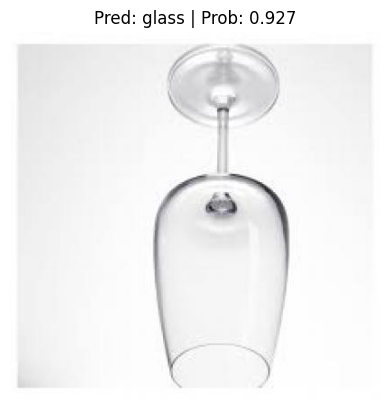

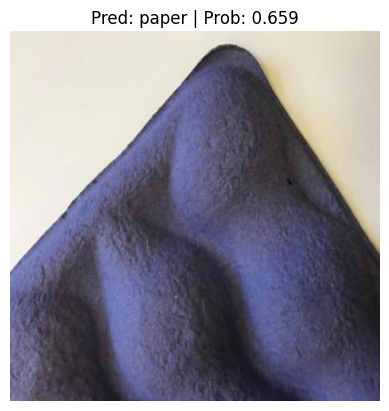

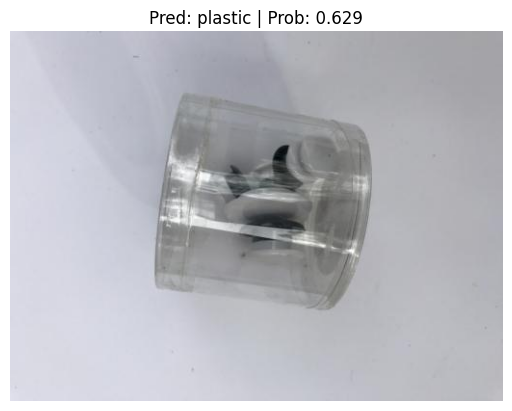

In [77]:
# Import function to make prediction on images and plot them
from modular_scripts.utils import pred_and_plot_image

# Get a random list of 6 path names from the val dataset
import random
num_images_to_plot = 3
val_image_path_list = list(Path(image_path_augmented/ "val").glob("*/*.jpg"))
val_image_paths = random.sample(val_image_path_list, k=num_images_to_plot)

print('[INFO] Best performing model predictions:')
print('-'*50 + '\n')
# Make predictions
for image_path in val_image_paths:
  pred_and_plot_image(model=best_model,
                      image_path=image_path,
                      class_names=new_class_names,
                      image_size=[224,224],
                      device=device)

[INFO] Second best performing model predictions:
--------------------------------------------------



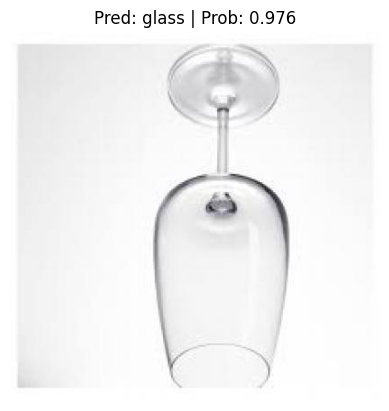

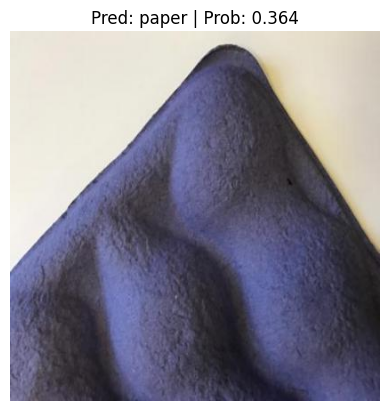

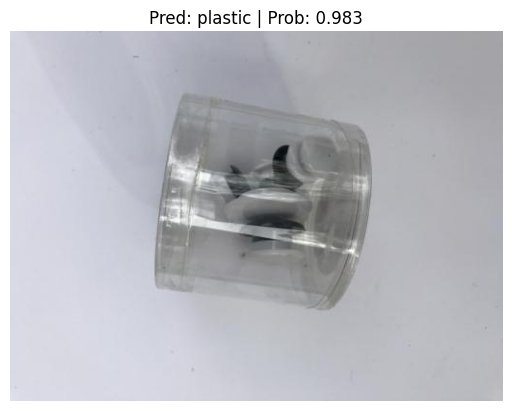

In [78]:
print('[INFO] Second best performing model predictions:')
print('-'*50 + '\n')
# Make predictions
for image_path in val_image_paths:
  pred_and_plot_image(model=second_best_model,
                      image_path=image_path,
                      class_names=new_class_names,
                      image_size=[224,224],
                      device=device)

### 9.1 Make predictions on custom images

[INFO] Best performing model predictions:
--------------------------------------------------



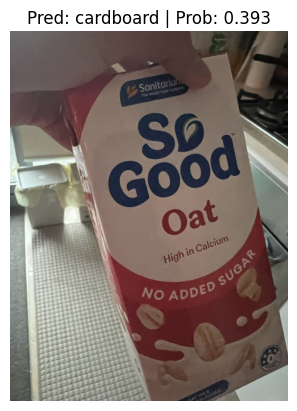

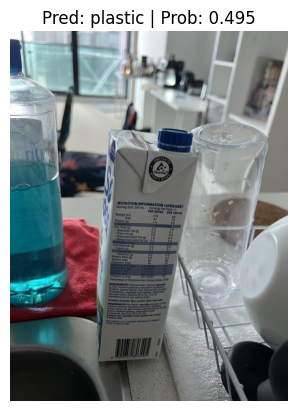

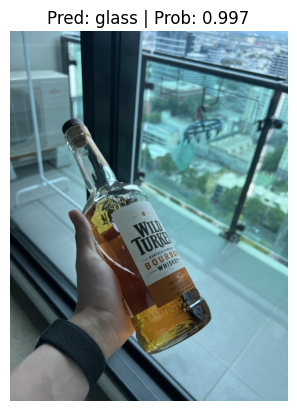

In [90]:
# Get custom images file path
custom_images_path_list = list(Path("data/custome_images").glob("*.JPEG"))
custom_images_path = random.sample(custom_images_path_list, k=num_images_to_plot)

print('[INFO] Best performing model predictions:')
print('-'*50 + '\n')
# Make predictions
for image_path in custom_images_path:
  pred_and_plot_image(model=best_model,
                      image_path=image_path,
                      class_names=new_class_names,
                      image_size=[224,224],
                      device=device)


[INFO] Second best performing model predictions:
--------------------------------------------------



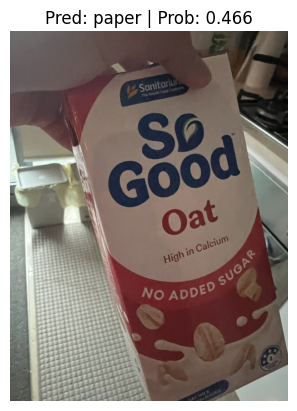

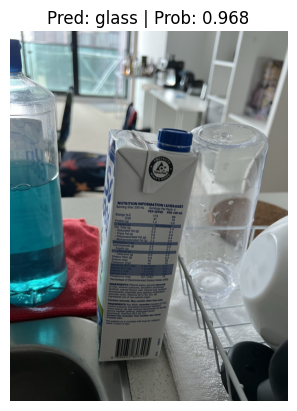

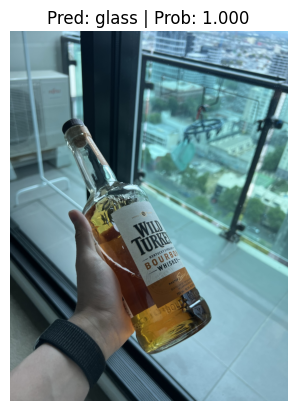

In [91]:
print('[INFO] Second best performing model predictions:')
print('-'*50 + '\n')
# Make predictions
for image_path in custom_images_path:
  pred_and_plot_image(model=second_best_model,
                      image_path=image_path,
                      class_names=new_class_names,
                      image_size=[224,224],
                      device=device)